## UMAP clustering of multiple samples    
    - 102 epochs initial (kmeans)
    - 70 additional epochs (kmeans) on 
    ```
    Incenp sgRNA #1	190219_195942-V	G5	
    Incenp sgRNA #2	190219_195942-V	G8	
    No sgRNA Pt11_r01_c12
    ```
    - test: 
    
    ```
    Incenp sgRNA #1	190219_195942-V	G5	
    Incenp sgRNA #2	190219_195942-V	G8	
    No sgRNA Pt11_r01_c12
    ```
    - clustering with UMAP

**NOTE** UMAP without PCA and clustering with kmeans

In [1]:
import time
import matplotlib.pyplot as plt
import os
import numpy as np
import anndata as ad
import torch
from sklearn.decomposition import PCA
from torch import nn
from torch import optim
import torch.nn.functional as F
from torchvision import datasets, transforms, models
from PIL import Image
from torch.autograd import Variable
from util import load_model
from util import AverageMeter, Logger, UnifLabelSampler
import shutil
import seaborn as sn
import scanpy.api as sc
import pandas as pd

/home/aogorodnikov/anaconda3/envs/imgSudoku/lib/python3.7/site-packages/sklearn/externals/joblib/__init__.py:15: DeprecationWarning: sklearn.externals.joblib is deprecated in 0.21 and will be removed in 0.23. Please import this functionality directly from joblib, which can be installed with: pip install joblib. If this warning is raised when loading pickled models, you may need to re-serialize those models with scikit-learn 0.21+.
  warnings.warn(msg, category=DeprecationWarning)


In [2]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [3]:
model=load_model('../model_alex_add10/checkpoint.pth.tar')

=> no checkpoint found at '../model_alex_add10/checkpoint.pth.tar'


In [4]:
model.cuda()
model.eval()


AttributeError: 'NoneType' object has no attribute 'cuda'

In [ ]:
model.top_layer = None
model.classifier = nn.Sequential(*list(model.classifier.children())[:-1])

In [ ]:
def compute_features(dataloader, model, N):
    
    batch_time = AverageMeter()
    end = time.time()
    model.eval()
    # discard the label information in the dataloader
    for i, (input_tensor, _) in enumerate(dataloader):
        with torch.no_grad():
            input_var = torch.autograd.Variable(input_tensor.cuda())
            aux = model(input_var).data.cpu().numpy()
            if i == 0:
                features = np.zeros((N, aux.shape[1])).astype('float32')

            if i < len(dataloader) - 1:
                features[i * 256: (i + 1) * 256] = aux.astype('float32')
            else:
                # special treatment for final batch
                features[i * 256:] = aux.astype('float32')

            # measure elapsed time
            batch_time.update(time.time() - end)
            end = time.time()
        

    return features

In [ ]:
data_dir = '/home/aogorodnikov/data'

normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                     std=[0.229, 0.224, 0.225])
tra = [transforms.Resize(256),
       transforms.CenterCrop(224),
       transforms.ToTensor(),
       normalize]
dataset = datasets.ImageFolder(data_dir, transform=transforms.Compose(tra))
dataloader = torch.utils.data.DataLoader(dataset,
                                         batch_size=256,
                                         num_workers=8,
                                         pin_memory=True)



In [6]:
features = compute_features(dataloader, model, len(dataset))

NameError: name 'compute_features' is not defined

In [5]:
features.shape

NameError: name 'features' is not defined

In [11]:
# get the file names
dataset.samples[0][0]
samples = [x[0] for x in dataset.samples]


In [12]:
# construct AnnData obj
adata = ad.AnnData(X=features, obs = samples)
adata.obs["well"] = adata.obs.iloc[:,0].str.extract(r'(Pt\d+_r\d+c\d+)')


In [45]:
%%time 
#pca = PCA(svd_solver='randomized', whiten=True).fit(adata)
sc.tl.pca(adata, n_comps=256, svd_solver='randomized')

CPU times: user 2min 48s, sys: 0 ns, total: 2min 48s
Wall time: 26.5 s


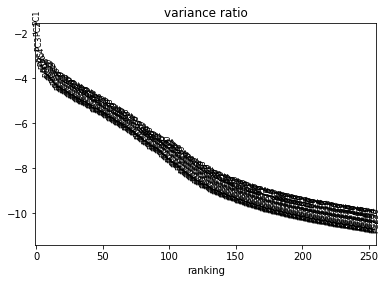

In [46]:
sc.pl.pca_variance_ratio(adata, log=True, n_pcs=256)


In [47]:
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=256)

In [48]:
sc.tl.umap(adata)

In [49]:
adata

AnnData object with n_obs × n_vars = 203428 × 4096 
    obs: 0, 'well'
    uns: 'pca', 'neighbors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'

In [178]:
sc.tl.louvain(adata, resolution=1)

In [179]:
sc.tl.leiden(adata, resolution=1)

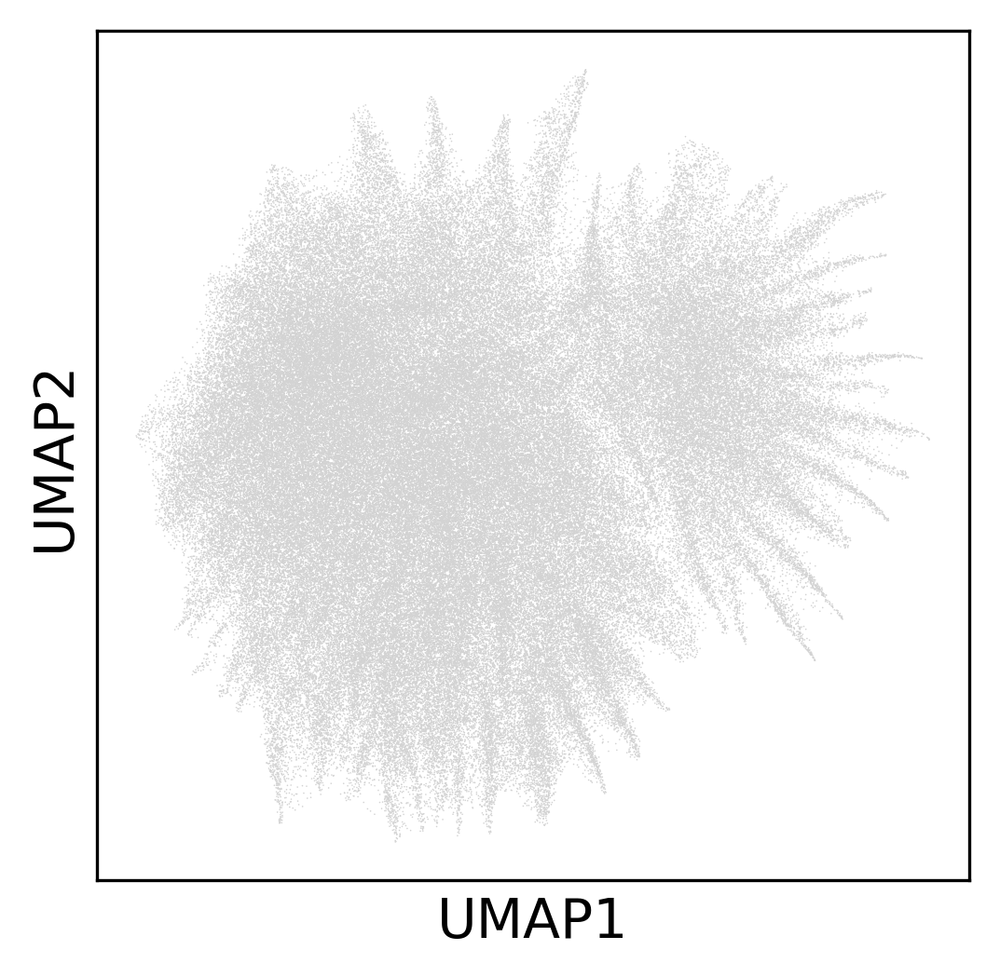

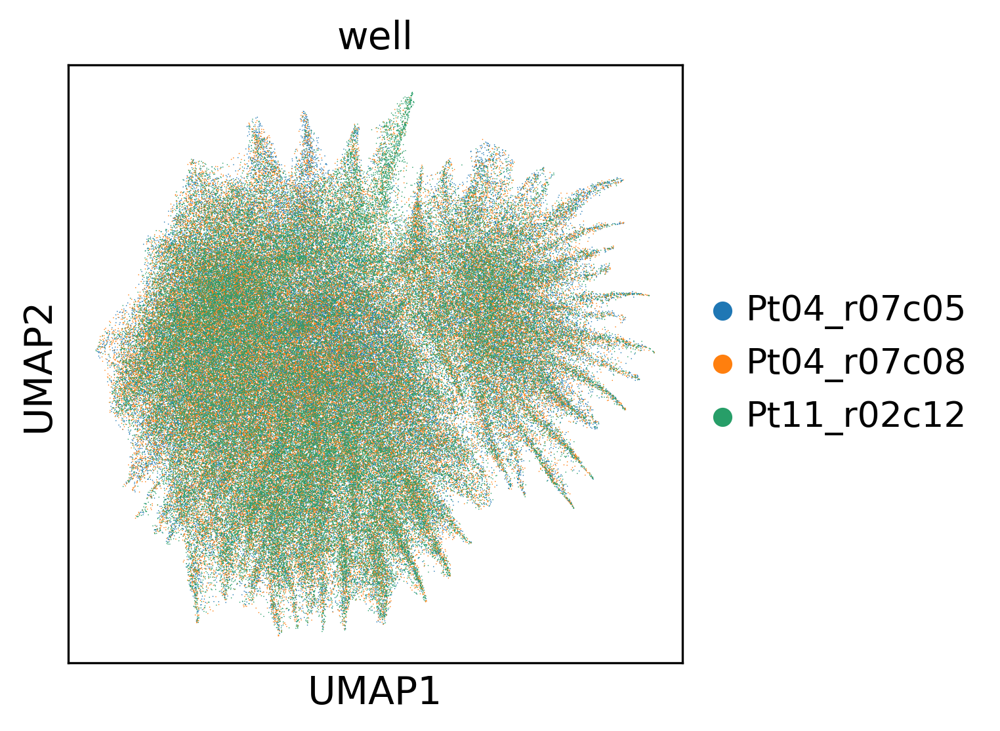

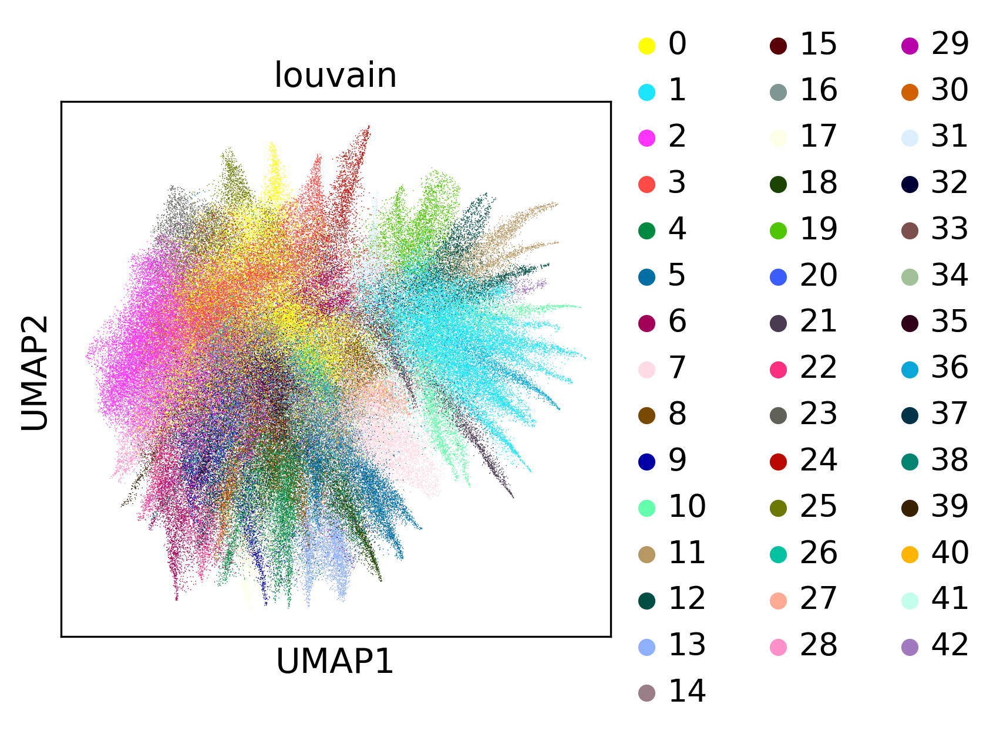

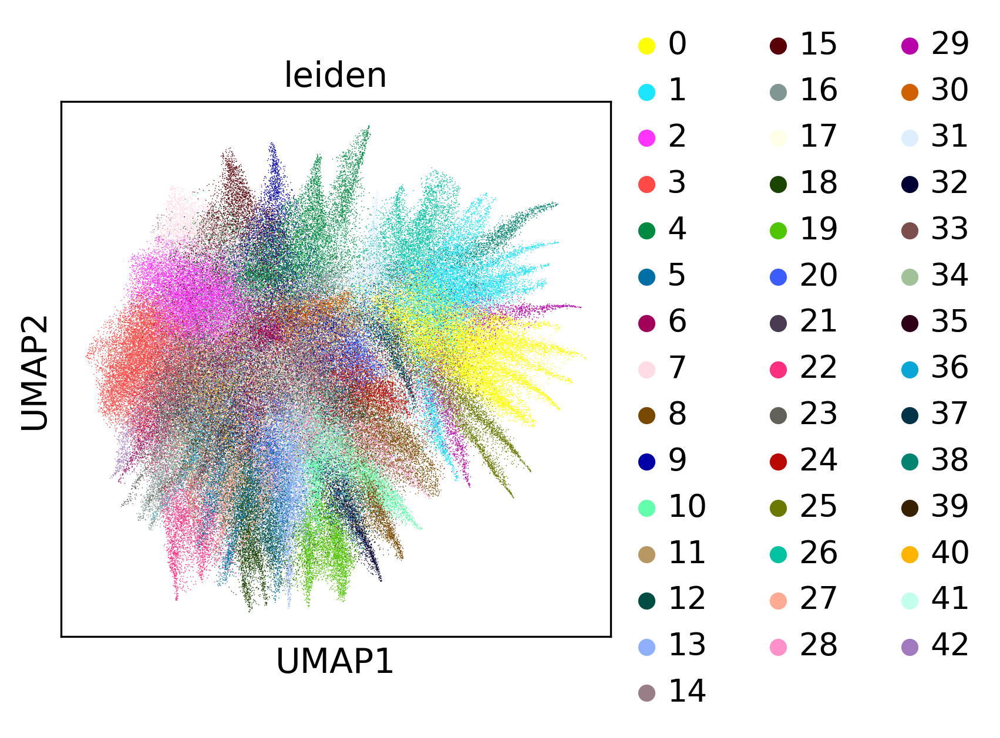

In [180]:
sc.settings.set_figure_params(dpi=150, color_map='viridis')
sc.pl.umap(adata)
sc.pl.umap(adata,color=['well'], use_raw=False)
sc.pl.umap(adata,color=['louvain'], use_raw=False)
sc.pl.umap(adata,color=['leiden'], use_raw=False)

In [38]:
pca_100 = PCA(n_components=256, svd_solver='randomized')
pca_result_100 = pca_100.fit_transform(adata.X)
print('Cumulative explained variation for 256 principal components: {}'.format(np.sum(pca_100.explained_variance_ratio_)))

Cumulative explained variation for 256 principal components: 0.9957738616040792


In [13]:
import umap
from sklearn.datasets import fetch_mldata
import matplotlib.pyplot as plt
import seaborn as sns

In [14]:
# euclidean

reducer = umap.UMAP(random_state=42)
embedding_euc = reducer.fit_transform(adata.X)

### Add k-menas clustering results

In [15]:
import pickle
import os
import sys
import numpy as np
from glob import glob
from sklearn.metrics.cluster import normalized_mutual_info_score
import seaborn as sn
import matplotlib.pyplot as plt
import json
import cv2




In [16]:
def arrange_clustering(images_lists):
    pseudolabels = []
    image_indexes = []
    for cluster, images in enumerate(images_lists):
        image_indexes.extend(images)
        pseudolabels.extend([cluster] * len(images))
    indexes = np.argsort(image_indexes)
    return np.asarray(pseudolabels)[indexes]

#### Links to files

In [17]:
clusters = "/home/aogorodnikov/model_alex_add10/clusters"
imgs = "/home/aogorodnikov/data/train"

In [18]:
with open(clusters, "rb") as f:
    b = pickle.load(f, encoding='latin1')

In [19]:
# clusters which each img belongs to at every epoch
img_clust = [arrange_clustering(x) for x in b]    

In [20]:
im_names = [os.path.basename(x) for x in sorted(glob(os.path.join(imgs, '*.tif*')))]

In [26]:
epoch = 50

In [27]:
# Class of image clusters to export as JSON
# clusters - list of clustes
# images - array of images that were identified for this cluster

class Cluster(object):
  def __init__(self, clusters, images):
    self.clusters = []
    self.images = []
    
  def clust_append(self, cur_clust, im_id):
    self.clusters.append(cur_clust)
    self.images.append(im_id)
    

In [29]:
# create an object with attributes "clusters" and "images"
myObj = Cluster("Cluster", "Image")

# loop over clusters (j)
for j in range(0,len(b[epoch])):
    rel_img = [im_names[x] for x in np.where(img_clust[epoch] == j)[0]]
    myObj.clust_append(j, rel_img)
    


### Plotting DFs

In [174]:
df_clust = pd.DataFrame()
for numb, i in enumerate(myObj.images):
    res = pd.DataFrame({'img': i, 'clust': ["cluster_{}".format(myObj.clusters[numb])] * len(i)})
    df_clust = df_clust.append(res, ignore_index=True)
    
df_clust['image_ID'] = [os.path.splitext(x)[0] for x in df_clust.iloc[:,0]]

#df_clust.shape

,img,clust,image_ID
49090,Pt04_r07c05_f01_0000.tif,cluster_27,Pt04_r07c05_f01_0000
59685,Pt04_r07c05_f01_0001.tif,cluster_30,Pt04_r07c05_f01_0001
122426,Pt04_r07c05_f01_0002.tif,cluster_58,Pt04_r07c05_f01_0002
137989,Pt04_r07c05_f01_0003.tif,cluster_66,Pt04_r07c05_f01_0003
131928,Pt04_r07c05_f01_0004.tif,cluster_63,Pt04_r07c05_f01_0004


### Creating multiple df with 10 clusters and the rest blocked out

In [183]:
df_clust = pd.DataFrame()
for numb, i in enumerate(myObj.images):
    img = i
    if numb < 10: 
        clustID = ["cluster_{}".format(myObj.clusters[numb])] * len(i)
        
    else:
        clustID = ["blank"] * len(i)
    res = pd.DataFrame({'img': img, 'clust': clustID})
    df_clust = df_clust.append(res, ignore_index=True)
    
df_clust['image_ID'] = [os.path.splitext(x)[0] for x in df_clust.iloc[:,0]]


In [184]:
df_emb = pd.DataFrame(embedding_euc)
df_emb['well'] = adata.obs["well"].tolist()
df_emb['image_ID'] = [os.path.splitext(os.path.basename(x))[0] for x in adata.obs.iloc[:,0]]
df_emb = df_emb.merge(df_clust[['clust', 'image_ID']], on='image_ID')


df_emb = df_emb.sample(frac=1).reset_index(drop=True)
df_emb.sort_values('image_ID').head()




,0,1,well,image_ID,clust
111173,-1.144480,1.879032,Pt04_r07c05,Pt04_r07c05_f01_0000,blank
184657,0.682322,-3.781922,Pt04_r07c05,Pt04_r07c05_f01_0001,blank
183283,0.769511,0.016329,Pt04_r07c05,Pt04_r07c05_f01_0002,blank
62475,-3.660025,3.749197,Pt04_r07c05,Pt04_r07c05_f01_0003,blank
149193,-3.232510,3.858640,Pt04_r07c05,Pt04_r07c05_f01_0004,blank


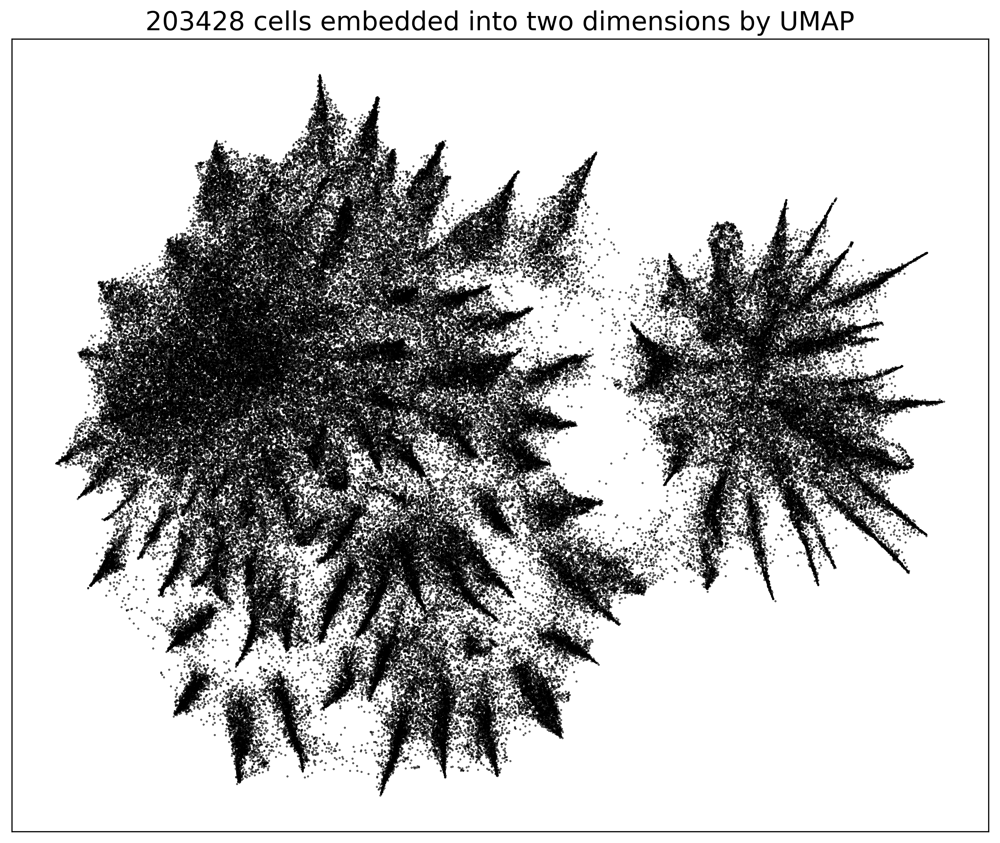

In [64]:
fig, ax = plt.subplots(figsize=(12, 10))
plt.scatter(
    embedding_euc[:, 0], embedding_euc[:, 1], c='black', cmap="Spectral", s=0.1
)
plt.setp(ax, xticks=[], yticks=[])
plt.title("203428 cells embedded into two dimensions by UMAP", fontsize=18)

plt.show()

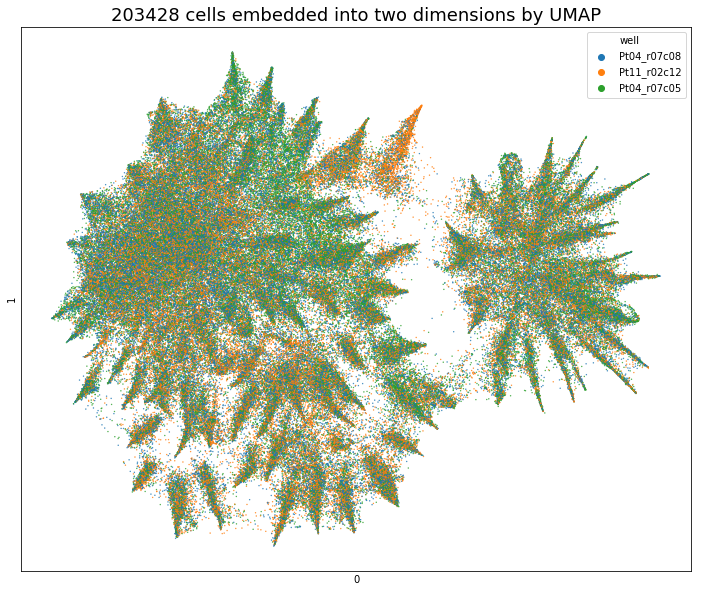

In [42]:
fig, ax = plt.subplots(figsize=(12, 10))
sn.scatterplot(df_emb.iloc[:, 0], df_emb.iloc[:, 1], hue=df_emb.well, s=0.5, edgecolor=None, alpha = 0.7)
plt.title("203428 cells embedded into two dimensions by UMAP", fontsize=18)
plt.setp(ax, xticks=[], yticks=[])


plt.show()

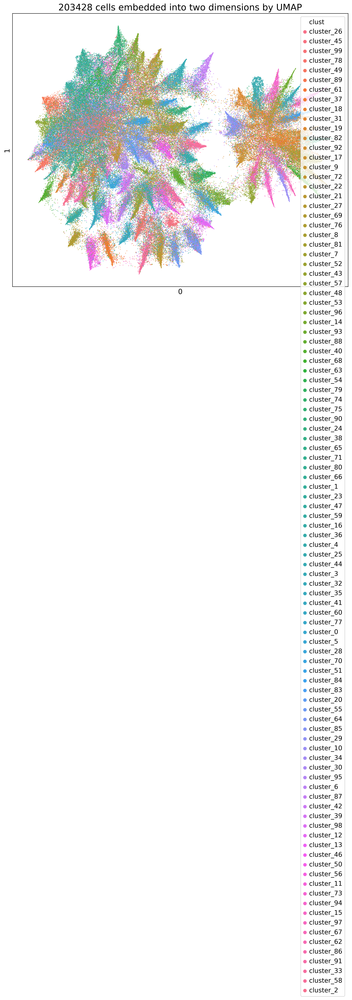

In [177]:
fig, ax = plt.subplots(figsize=(12, 10))
sn.scatterplot(df_emb.iloc[:, 0], df_emb.iloc[:, 1], hue=df_emb.clust, s=0.5, edgecolor=None, alpha = 0.7, legend="full")
plt.title("203428 cells embedded into two dimensions by UMAP", fontsize=18)
plt.setp(ax, xticks=[], yticks=[])


plt.show()

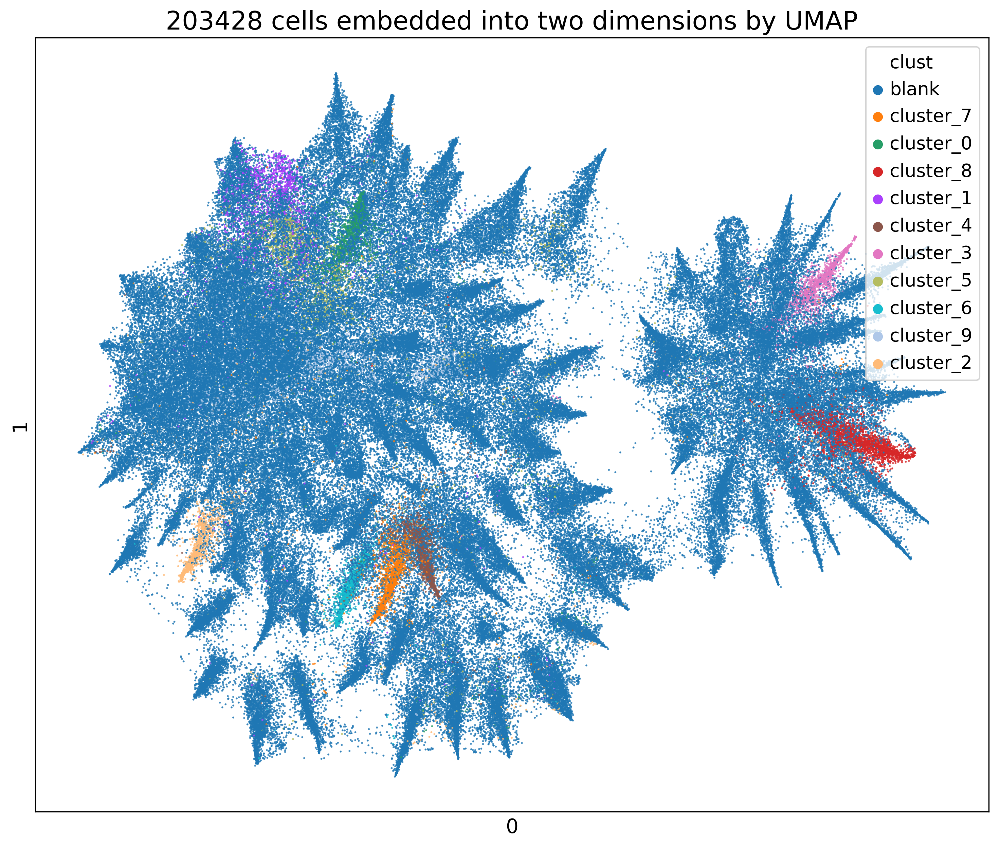

In [185]:
fig, ax = plt.subplots(figsize=(12, 10))
sn.scatterplot(df_emb.iloc[:, 0], df_emb.iloc[:, 1], hue=df_emb.clust, s=0.5, edgecolor=None, alpha = 0.7, legend="full")
plt.title("203428 cells embedded into two dimensions by UMAP", fontsize=18)
plt.setp(ax, xticks=[], yticks=[])


plt.show()

In [188]:
df_clust = pd.DataFrame()
for numb, i in enumerate(myObj.images):
    img = i
    if numb in range(10,20): 
        clustID = ["cluster_{}".format(myObj.clusters[numb])] * len(i)
        
    else:
        clustID = ["blank"] * len(i)
    res = pd.DataFrame({'img': img, 'clust': clustID})
    df_clust = df_clust.append(res, ignore_index=True)
    
df_clust['image_ID'] = [os.path.splitext(x)[0] for x in df_clust.iloc[:,0]]


In [189]:
df_emb = pd.DataFrame(embedding_euc)
df_emb['well'] = adata.obs["well"].tolist()
df_emb['image_ID'] = [os.path.splitext(os.path.basename(x))[0] for x in adata.obs.iloc[:,0]]
df_emb = df_emb.merge(df_clust[['clust', 'image_ID']], on='image_ID')


df_emb = df_emb.sample(frac=1).reset_index(drop=True)
df_emb.sort_values('image_ID').head()




,0,1,well,image_ID,clust
150765,-1.144480,1.879032,Pt04_r07c05,Pt04_r07c05_f01_0000,blank
155945,0.682322,-3.781922,Pt04_r07c05,Pt04_r07c05_f01_0001,blank
27735,0.769511,0.016329,Pt04_r07c05,Pt04_r07c05_f01_0002,blank
151992,-3.660025,3.749197,Pt04_r07c05,Pt04_r07c05_f01_0003,blank
153372,-3.232510,3.858640,Pt04_r07c05,Pt04_r07c05_f01_0004,blank


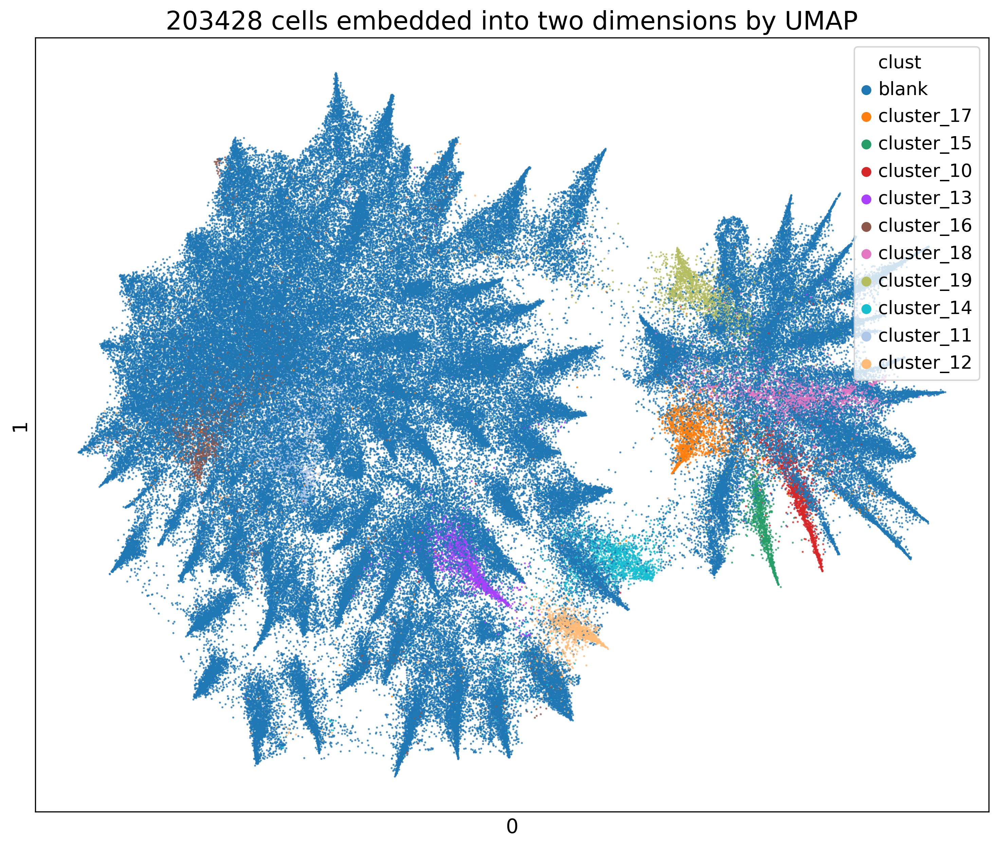

In [190]:
fig, ax = plt.subplots(figsize=(12, 10))
sn.scatterplot(df_emb.iloc[:, 0], df_emb.iloc[:, 1], hue=df_emb.clust, s=0.5, edgecolor=None, alpha = 0.7, legend="full")
plt.title("203428 cells embedded into two dimensions by UMAP", fontsize=18)
plt.setp(ax, xticks=[], yticks=[])


plt.show()

In [191]:
df_clust = pd.DataFrame()
for numb, i in enumerate(myObj.images):
    img = i
    if numb in range(21,30): 
        clustID = ["cluster_{}".format(myObj.clusters[numb])] * len(i)
        
    else:
        clustID = ["blank"] * len(i)
    res = pd.DataFrame({'img': img, 'clust': clustID})
    df_clust = df_clust.append(res, ignore_index=True)
    
df_clust['image_ID'] = [os.path.splitext(x)[0] for x in df_clust.iloc[:,0]]


In [192]:
df_emb = pd.DataFrame(embedding_euc)
df_emb['well'] = adata.obs["well"].tolist()
df_emb['image_ID'] = [os.path.splitext(os.path.basename(x))[0] for x in adata.obs.iloc[:,0]]
df_emb = df_emb.merge(df_clust[['clust', 'image_ID']], on='image_ID')


df_emb = df_emb.sample(frac=1).reset_index(drop=True)
df_emb.sort_values('image_ID').head()




,0,1,well,image_ID,clust
76787,-1.144480,1.879032,Pt04_r07c05,Pt04_r07c05_f01_0000,cluster_27
81741,0.682322,-3.781922,Pt04_r07c05,Pt04_r07c05_f01_0001,blank
129227,0.769511,0.016329,Pt04_r07c05,Pt04_r07c05_f01_0002,blank
45947,-3.660025,3.749197,Pt04_r07c05,Pt04_r07c05_f01_0003,blank
127210,-3.232510,3.858640,Pt04_r07c05,Pt04_r07c05_f01_0004,blank


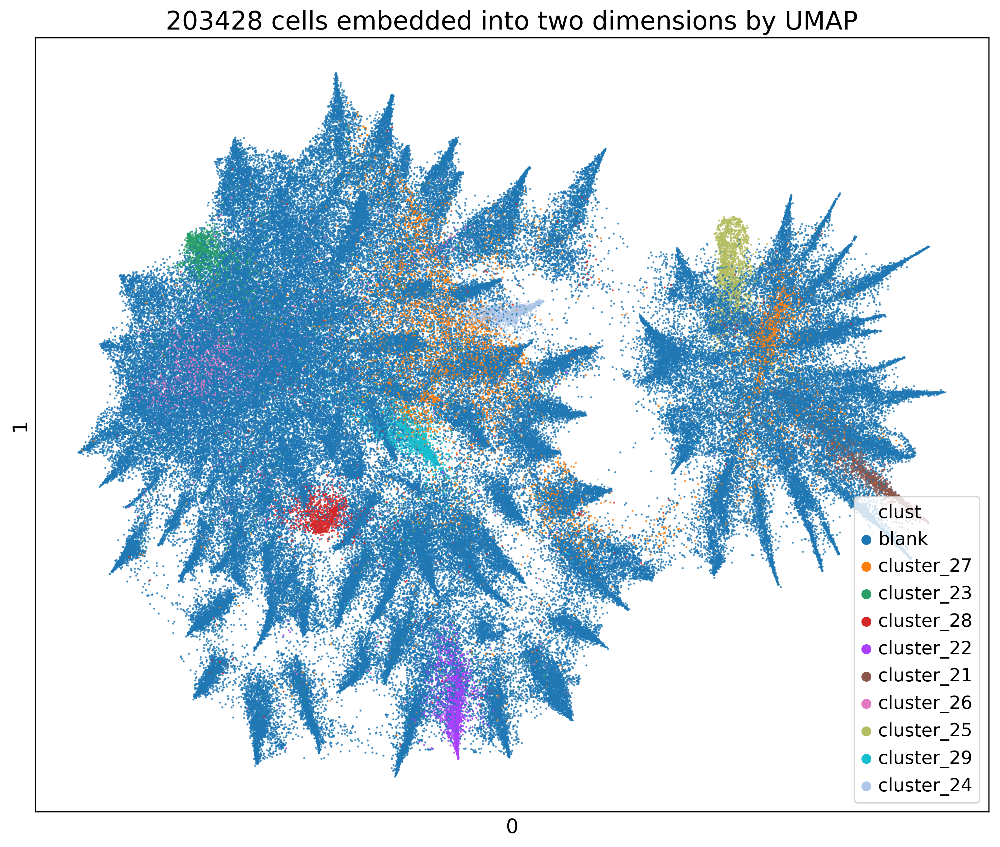

In [193]:
fig, ax = plt.subplots(figsize=(12, 10))
sn.scatterplot(df_emb.iloc[:, 0], df_emb.iloc[:, 1], hue=df_emb.clust, s=0.5, edgecolor=None, alpha = 0.7, legend="full")
plt.title("203428 cells embedded into two dimensions by UMAP", fontsize=18)
plt.setp(ax, xticks=[], yticks=[])


plt.show()